In [1]:
import os
import numpy as np
import segyio
from scipy import stats
from multiprocessing import Pool

np.set_printoptions(threshold=np.inf) # Print the entire dataframe

from shutil import copyfile




# from pathlib import Path

In [2]:
from pathlib import Path
data_dir = Path("../data")

In [3]:

data_dir / "N1189-2508_1199-2518.sgy"

PosixPath('../data/N1189-2508_1199-2518.sgy')

# Data to use

In [4]:
# Seismic data: SEG-Y format
near_stack = os.path.join("..", "data", "N1189-2508_1199-2518.sgy")
mid_stack = os.path.join("..", "data", "M1189-2508_1199-2518.sgy")
far_stack = os.path.join("..", "data", "F1189-2508_1199-2518.sgy")

# =======================================
#near_stack = "N1189-2508_1199-2518.sgy"
#path_n = data_dir / near_stacktack

# Wells data: txt format
wells_path = '../data/wells_info.txt'

# Store the seismic data in a list
gather_path = [near_stack, mid_stack, far_stack]

# Input parameters to work with


In [5]:
# Name of the survery to display in the results
seismic_survey = 'POSEIDON 3D'

# Name and path of the merged SEG-Y file
merged_stacks = os.path.join("..", "data", "NMF1189-2508_1199-2518.sgy")

# Gradient file (SEGY)
gradient_segy = os.path.join("..", "data", "gradient.sgy")
# Intercept file (SEGY)
intercept_segy = os.path.join("..", "data", "intercept.sgy")
# Intercept file (SEGY)
rvalue_segy = os.path.join("..", "data", "correlation_c.sgy")
# Intercept file (SEGY)
pvalue_segy = os.path.join("..", "data", "pvalue.sgy")
# Intercept file (SEGY)
stderr_segy = os.path.join("..", "data", "standard_dev.sgy")

# Angle between the gathers given
angle_bet_gathers = 12

# Making a list with the angle of the gathers
angle_list = []
angle = angle_bet_gathers
for file in range(len(gather_path)):
    angle_list = angle_list + [angle]
    angle = angle + angle_bet_gathers

# Merging the partial angle stacks


In [4]:
def merging_stacks(list_of_gathers, merged_file_path, list_of_angles):
    
    """
    
    source1: https://github.com/equinor/segyio/blob/master/python/examples/make-file.py
    source2: https://github.com/equinor/segyio/blob/master/python/segyio/tracefield.py
    
    """
    
    # Validating the files
#    for file in list_of_gathers:
#        if file_validation(file) == True:
#            print(f"{file} has been validated")
#        else:
#            return(f"Unsuccessful validation: {file_validation(file)}")
    
    # Making the offset array
    offsts = np.array(list_of_angles)

    # Initializing the stacks
    with segyio.open(list_of_gathers[0]) as f, segyio.open(list_of_gathers[1]) as g, segyio.open(list_of_gathers[2]) as h:
        
        # Spec function to build the new segy
        spec = segyio.spec()
        spec.sorting = f.sorting
        spec.format = 1
        spec.samples = f.samples
        spec.ilines = f.ilines
        spec.xlines = f.xlines
        spec.offsets = offsts

        # Initializing the merged one
        with segyio.create(merged_file_path, spec) as s:
        
            # Index for the merge headers and trace
            merge_index = 0
            # Index for the original file's headers and trace
            stack_index = 0
            # For loop to set parameters according to the seismic lines and offset
            for il in spec.ilines:
                for xl in spec.xlines:
                    for offset in spec.offsets:
                        # Assigning headers [byte]
                        s.header[merge_index] = {segyio.su.tracl  : f.header[stack_index][1],
                                                 segyio.su.tracr  : f.header[stack_index][5],
                                                 segyio.su.fldr   : f.header[stack_index][9],
                                                 segyio.su.cdp    : f.header[stack_index][21],
                                                 segyio.su.cdpt   : f.header[stack_index][25],
                                                 segyio.su.offset : offset, # 37
                                                 segyio.su.scalco : f.header[stack_index][71],
                                                 segyio.su.ns     : f.header[stack_index][115],
                                                 segyio.su.dt     : f.header[stack_index][117],
                                                 segyio.su.cdpx   : f.header[stack_index][181],
                                                 segyio.su.cdpy   : f.header[stack_index][185],
                                                 segyio.su.iline  : il,  # 189
                                                 segyio.su.xline  : xl}  # 193
                        if offset == list_of_angles[0]:
                            stack = f # near
                        if offset == list_of_angles[1]:
                            stack = g # mid
                        if offset == list_of_angles[2]:
                            stack = h # far                   
                        
                        # Copying the amplitudes from each stack
                        s.trace[merge_index] = stack.trace[stack_index]
                        
                        merge_index += 1
                    stack_index += 1
                
    return (f"Successful merge. New SEG-Y file path: {merged_file_path}")

In [5]:
merging_stacks(gather_path, merged_stacks, angle_list)

'Successful merge. New SEG-Y file path: ../data/NMF1189-2508_1199-2518.sgy'

# First version of multiprocess avo attributes [21 min]
## Doing:
- Builds the SEG-Y to store the data from Scipy's [gradient, intercept, rvalue, pvalue, stderr]
- Calculates and stores AVO attributes and it's statistical parameters in the SEG-Ys previously mentioned
- Multiprocess uses Maxtaskperchild and chunksize = 1

## Making the SEG-Y files to store the AVO attributes

In [6]:
def avo_storing_files(list_of_gathers, gradient_path, intercept_path, rvalue_path, pvalue_path, stderr_path): 
    # Initializing the stacks
    with segyio.open(list_of_gathers[0]) as f:
        
        # Spec function to build the new segy
        spec = segyio.tools.metadata(f)

        # Initializing the merged one
        with segyio.create(gradient_path, spec) as gradient:

            # Assigning headers [byte]
            gradient.text[0] = f.text[0]
            gradient.bin = f.bin
            gradient.header = f.header
            gradient.trace = f.trace
            
        print(f"Successful construction. Gradient path: ({gradient_path})")
            
    
    # Making copies of the new segy
    copyfile(gradient_path, intercept_path)
    print(f"Successful construction. Intercept path: ({intercept_path})")
    copyfile(gradient_path, rvalue_path)
    print(f"Successful construction. Correlation coeficient path: ({rvalue_path})")
    copyfile(gradient_path, pvalue_path)
    print(f"Successful construction. Pvalue path: ({pvalue_path})")
    copyfile(gradient_path, stderr_path)
    print(f"Successful construction. Standard Deviation path: ({stderr_path})")

    return

In [7]:
avo_storing_files(gather_path, gradient_segy, intercept_segy, rvalue_segy, pvalue_segy, stderr_segy)

Successful construction. Gradient path: (../data/gradient.sgy)
Successful construction. Intercept path: (../data/intercept.sgy)
Successful construction. Correlation coeficient path: (../data/correlation_c.sgy)
Successful construction. Pvalue path: (../data/pvalue.sgy)
Successful construction. Standard Deviation path: (../data/standard_dev.sgy)


## Function to give arguments to the pool

In [8]:
def input_generator(gather_file, list_of_angles, 
                    gradient_path, intercept_path, rvalue_path, pvalue_path, stderr_path):
    """
    
    """
    index = 0
    with segyio.open(gather_file, "r") as gather:
        for iline_number in gather.ilines:
            for xline_number in gather.xlines:
                    yield [gather_file, list_of_angles, iline_number, xline_number, index, 
                           gradient_path, intercept_path, rvalue_path, pvalue_path, stderr_path]
                    index += 1
#### test it
#input_args = input_generator(merged_stacks, angle_list, 
#                             gradient_segy, intercept_segy, rvalue_segy, pvalue_segy, stderr_segy)
#for row in input_args:
#    print(row)

## Function to compute the AVO attributes by trace

### Second edition: vectorized function
the function below computes and stores the data because of this hypothesis: if two functions are applied, the one receiving the data could represent a lost of ram!!   


In [9]:
def  AVO_attributes_computation_2(generator_list):
    
    """
    
    """
    # Parameters to use in the functions
    gather_file = generator_list[0]
    list_of_angles = generator_list[1]
    iline_number = generator_list[2]
    xline_number = generator_list[3]
    index = generator_list[4]
    intercept_file = generator_list[5]
    gradient_file = generator_list[6]
    rvalue_file = generator_list[7]
    pvalue_file = generator_list[8]
    stderr_file = generator_list[9]
    
    # Initializing the sin(angle) list
    sins = []
    
    # Opening the gather to: 
                            #1) Create an empty array to store the values within the gather file
                            #2) Make multiple arrays to be used by segyio's trace function
    with segyio.open(gather_file, "r") as gather:
        gradient = np.zeros([len(gather.samples), ], dtype = "float32")
        intercept = np.zeros([len(gather.samples), ], dtype = "float32")
        rvalue = np.zeros([len(gather.samples), ], dtype = "float32")#Correlation coefficient.
        pvalue = np.zeros([len(gather.samples), ], dtype = "float32")
        stderr = np.zeros([len(gather.samples), ], dtype = "float32") #Standard error of the estimated gradient.
        
        # For loot to append the values for sins and to store the amplitudes in an array(3,1501)
        for angle in list_of_angles:
            sins += [np.sin(np.radians(angle)) * np.sin(np.radians(angle))]
            
            # If the angle is the first, then initialize the amp array
            if angle == list_of_angles[0]:
                amp = gather.gather[iline_number, xline_number, angle].reshape(len(gather.samples), 1)
            
            # If it's not the first angle in the list, concatenate to an existing variable (amp)
            else:
                amp = np.concatenate((amp, 
                                      gather.gather[iline_number, xline_number, angle].reshape(len(gather.samples), 
        
                                                                                               1)),axis=1)
        # the amp is was reshaped to (3, 1501) in order to introduce the amplitudes of a slice in the
        # Scipy function: has been VECTORIZED!!
        
        # For loop to select and to introduce values to Scipy's
        for row in range(amp.shape[0]):
            gradient[row], intercept[row], rvalue[row], pvalue[row], stderr[row] = stats.linregress(sins, amp[row])
        
    # Storing the data: Opening and closing the segy's. This should improve the perfomance of the function
    with segyio.open(gradient_file, "r+") as gradient_segy:
        gradient_segy.trace[index] = gradient

    with segyio.open(intercept_file, "r+") as intercept_segy:
        intercept_segy.trace[index] = intercept

    with segyio.open(rvalue_file, "r+") as rvalue_segy:
        rvalue_segy.trace[index] = rvalue

    with segyio.open(pvalue_file, "r+") as pvalue_segy:
        pvalue_segy.trace[index] = pvalue

    with segyio.open(stderr_file, "r+") as stderr_segy:
            stderr_segy.trace[index] = stderr
    
    print(f"AVO attributes for trace number {index}, [{iline_number},{xline_number}], has been stored successfully")
    return

#test it
#AVO_attributes_computation_2(merged_stacks, 2950, 2180, angle_list, 0,
#                             gradient_segy, intercept_segy, rvalue_segy, pvalue_segy, stderr_segy)
## TASTE it (2)
#input_args = input_generator(merged_stacks, angle_list, 
#                             gradient_segy, intercept_segy, rvalue_segy, pvalue_segy, stderr_segy)
#
#for row in input_args:
#    print(AVO_attributes_computation_2(row))

## Integrating the previous functions [MP]

In [10]:
import time

In [11]:
def avo_storeputation(gather_file, list_of_angles, 
                      gradient_file, intercept_file, rvalue_file, pvalue_file, stderr_file):
    
    input_args = input_generator(merged_stacks, angle_list, 
                             gradient_segy, intercept_segy, rvalue_segy, pvalue_segy, stderr_segy)
    
    if __name__ == "__main__":
        p = Pool(maxtasksperchild=1)
        p.map(AVO_attributes_computation_2, input_args, chunksize=1)

In [12]:
%%time
avo_storeputation(merged_stacks, angle_list,
                  gradient_segy, intercept_segy, rvalue_segy, pvalue_segy, stderr_segy)

AVO attributes for trace number 0, [1189,2508], has been stored successfully
AVO attributes for trace number 2, [1189,2510], has been stored successfully
AVO attributes for trace number 1, [1189,2509], has been stored successfully
AVO attributes for trace number 3, [1189,2511], has been stored successfully
AVO attributes for trace number 6, [1189,2514], has been stored successfully
AVO attributes for trace number 5, [1189,2513], has been stored successfully
AVO attributes for trace number 4, [1189,2512], has been stored successfully
AVO attributes for trace number 7, [1189,2515], has been stored successfully
AVO attributes for trace number 8, [1189,2516], has been stored successfully
AVO attributes for trace number 10, [1189,2518], has been stored successfully
AVO attributes for trace number 9, [1189,2517], has been stored successfully
AVO attributes for trace number 11, [1190,2508], has been stored successfully
AVO attributes for trace number 12, [1190,2509], has been stored successfu

AVO attributes for trace number 107, [1198,2516], has been stored successfully
AVO attributes for trace number 106, [1198,2515], has been stored successfully
AVO attributes for trace number 109, [1198,2518], has been stored successfully
AVO attributes for trace number 108, [1198,2517], has been stored successfully
AVO attributes for trace number 110, [1199,2508], has been stored successfully
AVO attributes for trace number 111, [1199,2509], has been stored successfully
AVO attributes for trace number 112, [1199,2510], has been stored successfully
AVO attributes for trace number 113, [1199,2511], has been stored successfully
AVO attributes for trace number 114, [1199,2512], has been stored successfully
AVO attributes for trace number 115, [1199,2513], has been stored successfully
AVO attributes for trace number 116, [1199,2514], has been stored successfully
AVO attributes for trace number 117, [1199,2515], has been stored successfully
AVO attributes for trace number 118, [1199,2516], ha

# To DO!!:
- cube size [X]
- chunks, maxtask [✓]
- store the other 3 scipy's parameters [✓]
- vectorize the for loops [✓]
- DelayRecordingTime: 0 [X]
- Use dask to make dataframes [X]


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
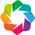

In [13]:
import datashader as ds
import holoviews as hv
from holoviews.operation.datashader import datashade, shade, dynspread, rasterize
from holoviews.operation import decimate
hv.extension("bokeh")

In [14]:
test = pd.DataFrame({"col1":np.arange(100), "col2":np.arange(100, 200)})
test2 = pd.DataFrame({"col1":np.arange(100), "col2":np.arange(200, 100, -1)})
test2

NameError: name 'pd' is not defined

In [ ]:
opts.defaults(opts.Scatter(tools=['box_select', 'lasso_select']))

points = hv.Scatter(test, ["col1", "col2"], vdims = ["col2"])
points2 = hv.Scatter(test2, ["col1", "col2"], vdims = ["col2"])
dat_options = dict(width = 500, height = 500, bgcolor = "white", tools=['box_select', 'lasso_select'])
#selection = streams.Selection1D(source=points*points2)
# Declare points as source of selection stream

#dmap = hv.DynamicMap(hv.Curve, streams=[Buffer(sdf.x, length=1000000)])

#plot1 = datashade(points, cmap = "black", normalization = "log").opts(plot = dat_options)
plot2 = datashade(points2, streams=[hv.streams.Selection1D(source=points2)], cmap = "black", normalization = "log").opts(plot = dat_options)

#z = plot1 * plot2

In [ ]:
plot2

In [ ]:
# Declare points as source of selection stream
selection = streams.Selection1D(source=points)

# Write function that uses the selection indices to slice points and compute stats
def selected_info(index):
    selected = points.iloc[index]
    if index:
        label = 'Mean x, y: %.3f, %.3f' % tuple(selected.array().mean(axis=0))
    else:
        label = 'No selection'
    return selected.relabel(label).opts(color='red')

# Combine points and DynamicMap
points + hv.DynamicMap(selected_info, streams=[selection])

In [ ]:
import numpy as np
import holoviews as hv
from holoviews import opts
from holoviews import streams
hv.extension('bokeh')

opts.defaults(opts.Points(tools=['box_select', 'lasso_select']))

# Declare some points
points = hv.Points(np.random.randn(1000,2 ))

# Declare points as source of selection stream
selection = streams.Selection1D(source=points)

# Combine points and DynamicMap
points

d = datashade(points, cmap = "black", normalization = "log").opts(plot = dat_options)

# one trace per row

In [192]:
def test():
    with segyio.open(gradient_segy, "r") as g, segyio.open(intercept_segy, "r") as f:
        for trace in range(f.tracecount):
            point_to_plot = 0
            
            point_to_plot = np.concatenate((g.trace[trace].reshape(1501,1), f.trace[trace].reshape(1501,1)) ,axis=1)
            
            yield {"iline": f.header[trace][189], "xline": f.header[trace][193],
                   "gradient,intercept": [point_to_plot]}   

# rows = samples

## Pandas dataframe

In [6]:
import pandas as pd

In [ ]:
            # A scalar (bytes 71-72) are usually aplied to the cdp coordinates in the trace headers:
            scalar = segy.attributes(segyio.TraceField.SourceGroupScalar)[:] # b (71-72)
            trace_coordinates['utmx'] = np.where(scalar == 0, trace_coordinates['utmx'],
                                            np.where(scalar > 0, trace_coordinates['utmx'] * scalar, 
                                                                    trace_coordinates['utmx'] / abs(scalar)))
            trace_coordinates['utmy'] = np.where(scalar == 0, trace_coordinates['utmy'],
                                            np.where(scalar > 0, trace_coordinates['utmy'] * scalar, 
                                                                    trace_coordinates['utmy'] / abs(scalar)))

In [98]:
def attributes_organization(gradient_file, intercept_file,
                            rvalue_file, pvalue_file, stderr_file,
                            inline_range, crossline_range,
                            time_window):
    
    with segyio.open(gradient_segy, "r") as g, segyio.open(intercept_segy, "r") as f:
        with segyio.open(rvalue_file, "r") as r, segyio.open(pvalue_file, "r") as p, segyio.open(stderr_file, "r") as s:
            pando = pd.DataFrame([])
            for i in range(g.tracecount):
                pando = pd.concat([pando, pd.DataFrame({"inline":g.header[i][189],
                                                        "crossline": g.header[i][193],
                                                         "utmx":g.header[i][181], "utmy":g.header[i][185],
                                                         "time_slice":g.samples,
                                                         "gradient":g.trace[i], "intercept":f.trace[i],
                                                         "rvalue":r.trace[i], "pvalue":p.trace[i], 
                                                         "sdeviation":s.trace[i],
                                                         "scalar" : g.header[i][71]})],
                                       ignore_index = True, axis="rows")
                
            pando['utmx'] = np.where(pando['scalar'] == 0, pando['utmx'],
                                            np.where(pando['scalar'] > 0, pando['utmx'] * pando['scalar'], 
                                                                    pando['utmx'] / abs(pando['scalar'])))
            pando['utmy'] = np.where(pando['scalar'] == 0, pando['utmy'],
                                            np.where(pando['scalar'] > 0, pando['utmy'] * pando['scalar'], 
                                                                    pando['utmy'] / abs(pando['scalar'])))
    
    pando = pando.drop(["scalar"], axis=1)
    
    return pando[(pando["time_slice"] >= time_window[0]) &
                 (pando["time_slice"] <= time_window[1]) &
                 (pando["inline"] >= inline_range[0]) &
                 (pando["inline"] <= inline_range[1]) &
                 (pando["crossline"] >= crossline_range[0]) &
                 (pando["crossline"] <= crossline_range[1])].reset_index(drop=True)

In [99]:
%%time 
pandas_dataframe = attributes_organization(gradient_segy, intercept_segy, 
                                           rvalue_segy, pvalue_segy, stderr_segy, 
                                           (1190, 1195), (2510, 2515),(2750, 3000))

pandas_dataframe

CPU times: user 1.82 s, sys: 1.18 s, total: 3 s
Wall time: 3.88 s


,inline,crossline,utmx,utmy,time_slice,gradient,intercept,rvalue,pvalue,sdeviation
0,1190,2510,399418.5,8466685.9,2752.0,12.544625,-17.384842,-0.915701,0.263273,7.629445
1,1190,2510,399418.5,8466685.9,2756.0,-1.688685,-8.903564,-0.221568,0.857765,39.185501
2,1190,2510,399418.5,8466685.9,2760.0,-11.924386,5.004315,0.109829,0.929940,45.289062
3,1190,2510,399418.5,8466685.9,2764.0,-7.563633,-0.557786,-0.022402,0.985737,24.892731
4,1190,2510,399418.5,8466685.9,2768.0,-5.000000,0.000000,0.000000,1.000000,0.000000
5,1190,2510,399418.5,8466685.9,2772.0,-11.004603,12.656801,0.924496,0.248973,5.218710
6,1190,2510,399418.5,8466685.9,2776.0,-11.332538,-1.808865,-0.132126,0.915640,13.570467
7,1190,2510,399418.5,8466685.9,2780.0,-5.429374,-17.525604,-0.640065,0.557815,21.037369
8,1190,2510,399418.5,8466685.9,2784.0,-0.280709,-3.893996,-0.592090,0.596606,5.299978
9,1190,2510,399418.5,8466685.9,2788.0,-2.169467,42.422180,0.769138,0.441371,35.248886


In [94]:
'{:f}'.format(pandas_dataframe["scalar"].iloc[0])

'-10.000000'

In [80]:
a

-10

## Dask dataframe from array

In [17]:
import pandas as pd, numpy as np
import dask
import dask.array as da, dask.dataframe as dd

In [18]:
def fff():   
    with segyio.open(gradient_segy, "r") as g, segyio.open(intercept_segy, "r") as i:
        # Dask arrays
        for trace in range(g.tracecount):
            trace_n = da.from_array(np.full((len(g.samples), ), g.header[trace][5]), chunks = len(g.samples))
            utmx = da.from_array(np.full((len(g.samples), ), g.header[trace][181]), chunks = len(g.samples))
            utmy = da.from_array(np.full((len(g.samples), ), g.header[trace][185]), chunks = len(g.samples))
            grad = da.from_array(g.trace[trace], chunks = len(g.samples))
            inter = da.from_array(i.trace[trace], chunks = len(i.samples))
            dask_list = [dd.from_array(trace_n),dd.from_array(utmx),dd.from_array(utmy), 
                         dd.from_array(grad), dd.from_array(inter)]
            if trace == 0:
                dask_dataframe = dd.concat(dask_list, axis = 1)                            
                dask_dataframe.columns = ["trace_number", "utmx","utmy", "gradient", "intercept"]
            if trace != 0:
                dask_row = dd.concat(dask_list, axis = 1)                            
                dask_row.columns = ["trace_number", "utmx","utmy", "gradient", "intercept"]
                dask_dataframe = dd.concat([dask_dataframe, dask_row], axis = 0)
                
    return dask_dataframe

In [19]:
%%time
dask_dataframe = fff()

CPU times: user 3.9 s, sys: 14.5 ms, total: 3.92 s
Wall time: 4 s


# Crossplot maker

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
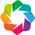

In [112]:
import datashader as ds
import holoviews as hv
from holoviews import opts
from holoviews import streams
from holoviews.operation.datashader import datashade, shade, dynspread, rasterize
from holoviews.operation import decimate
hv.extension("bokeh")
from bokeh.models import HoverTool
import time


import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm

In [ ]:
        def selected_info_cube(hc):
            traces_with_hc = pd.DataFrame([])
            for trace_number in hc["trace_number"]:
                traces_with_hc = pd.concat([traces_with_hc, dataframe[dataframe["trace_number"] == trace_number]], axis = 0)
            
            # Initializing the plot
            fig = plt.figure(figsize=(15, 15))
            ax = fig.add_subplot(111, projection='3d')

            # Assigning hc's data
            xhc = hc["utmx"].values
            yhc = hc["utmy"].values
            zhc = hc["time_slice"].values

            # Plotting the selected intervals
            plot = ax.scatter(xhc, yhc, zhc, zdir = 'z', s = 100, c = "red", depthshade = False, marker = "o", label = "Selected Points")

            # Configuring the plot
            ax.set_xlabel('Utmx [m]')
            ax.set_ylabel('Utmy [m]')
            ax.set_zlabel('Time slice [ms]')
            ax.invert_zaxis()
            ax.legend()
            
            return fig
        
        return plt.show()
        
        # Using the dataframes to plot whatever 
        no_hc = hv.Scatter(trace_with_hc, ["utmx", "utmy"], ["trace_number"])
        np_hc.opts(line_width = 1, color = "black",size = 5 ,marker = "^",
               padding = 0.1, width=600, height=400)
        hc = hv.Scatter(trace_with_hc, ["utmx", "utmy"], ["trace_number"])
        hc.opts(line_width = 1, color = "red",size = 5 ,marker = "^",
               padding = 0.1, width=600, height=400)
        
        
        
        
        
         norm=dict(framewise=True)

In [138]:
def crossplot(x_column, y_column, dataframe):
    """
    
    """
    # Tools to select data
    opts.defaults(opts.Points(tools=['box_select', 'lasso_select']))
    
    # Font size for plots
    f_size = {'ticks': '10pt', 'title': '20pt', 'ylabel': '15px', 'xlabel': '15px'}
    
    # Preparing the data's plot
    data = hv.Points(dataframe, [x_column, y_column])
    data.opts(color = "blue", size = 5, width = 600, height = 400, padding = 0.01,
              title = f"{x_column} vs {y_column}",fontsize = f_size,
              active_tools = ["box_select"],
              toolbar='above',
              framewise = True, show_grid = True)
    
    # Axis of plot
    x_axis = hv.Curve([(0,dataframe[y_column].min()), (0,dataframe[y_column].max())])
    x_axis.opts(color = "black", line_width = 0.5)
    y_axis = hv.Curve([(dataframe[x_column].min(), 0), (dataframe[x_column].max(), 0)])
    y_axis.opts(color = "black", line_width = 0.5)
    # Declare points as source of selection stream
    selection = streams.Selection1D(source = data)

    # Write function that uses the selection indices to slice points and compute stats
    def selected_info(index):
        hc = dataframe.iloc[index]
        plot = hv.Scatter(hc, ["utmx","utmy"])
        plot.opts(color = "red", size = 5, width = 600, height = 400, padding = 0.1, 
                  title = f"Poistion of the selected traces",fontsize = f_size, 
                  xformatter = "%.1f", yformatter = "%.1f",
                  toolbar='above',
                  tools = [HoverTool(tooltips=[('Trace [I/X]', f"@inline/@crossline"),
                                     ('Time [ms]', f"@time_slice")])],
                  framewise = True, show_grid = True)
      
        return plot

    dynamic_map = hv.DynamicMap(selected_info, streams = [selection])
         
    # Combine points and DynamicMap
    layout = ((data * x_axis * y_axis) + dynamic_map).opts(merge_tools=False)
    
    
    # DEACTIVATE SOME USELESS TOOLTIPS!!!
    return layout

In [139]:
x = crossplot("gradient", "intercept", pandas_dataframe)
x

:Layout
   .Overlay.I    :Overlay
      .Points.I :Points   [gradient,intercept]   (inline,crossline,utmx,utmy,time_slice,rvalue,pvalue,sdeviation)
      .Curve.I  :Curve   [x]   (y)
      .Curve.II :Curve   [x]   (y)
   .DynamicMap.I :DynamicMap   []
      :Scatter   [utmx,utmy]   (inline,crossline,time_slice,gradient,intercept,rvalue,pvalue,sdeviation)

# Panel

In [12]:
import panel as pn

In [107]:
def avo_visualization(gradient_file, intercept_file,
                      rvalue_file, pvalue_file, stderr_file):
    
    """

    """
    df = pd.DataFrame(columns = ["inline","crossline",
                                 "gradient","intercept","rvalue","pvalue","sdeviation"])
    # Window Selection
    inst = pn.widgets.StaticText(name = "Window to work with", value = "")
    
    iline_range = pn.widgets.IntRangeSlider(name = 'Inline range',
                                            start = 1189, 
                                            end = 1199, 
                                            value = (1189, 1199), 
                                            step = 1)
    
    xline_range = pn.widgets.IntRangeSlider(name = 'Crossline range',
                                            start = 2508, 
                                            end = 2518, 
                                            value = (2508, 2518), 
                                            step = 1)
    
    # Time slice selection
    slice_slider = pn.widgets.IntRangeSlider(name = 'Time slice [ms]',
                                             start = 0, 
                                             end = 6000, 
                                             value = (2750, 3000), 
                                             step = 250)
    
    # Crossplot checkbox
    check_box1 = pn.widgets.StaticText(name = "Crossplots paramaters", value = "")
    x_axis = pn.widgets.Select(name = "X axis", 
                              options = list(df.columns),
                              value = "gradient")
    y_axis = pn.widgets.Select(name = "Y axis", 
                              options = list(df.columns),
                              value = "intercept")
    

       
    # Decorator to mess up with the API
    @pn.depends(iline_range.param.value, xline_range.param.value,
                slice_slider.param.value,
                x_axis.param.value, y_axis.param.value)
    
    def avo_stuff(iline_range, xline_range, slice_slider,
                  x_axis, y_axis):
        
        attribute_dataframe = attributes_organization(gradient_file, intercept_file, 
                                               rvalue_file, pvalue_file, stderr_file, 
                                               iline_range, xline_range,
                                               slice_slider)
        
        crossplots = crossplot(x_axis, y_axis, attribute_dataframe)

        return(crossplots)
    
    w_width = 250
    w_height = 50
    row1 = pn.Row(inst, height=w_height, width=w_width)
    row2 = pn.Row(iline_range, height=w_height, width=w_width)
    row3 = pn.Row(xline_range, height=w_height, width=w_width)
    row4 = pn.Row(slice_slider, height=w_height, width=w_width)
    row5 = pn.Row(x_axis, y_axis, height=w_height, width=w_width)
    
    widgets = pn.WidgetBox(f"## AVO visualization", row1,
                                      row2,
                                      pn.Spacer(height = 10),
                                      row3,
                                      pn.Spacer(height = 10),
                                      row4,
                                      row5,
                          pn.Spacer(height = 10))
                        
    return((pn.Row(widgets, avo_stuff).servable()))

In [108]:
z = avo_visualization(gradient_segy, intercept_segy, rvalue_segy, pvalue_segy, stderr_segy)
z

Row
    [0] WidgetBox(css_classes=['widget-box'])
        [0] Markdown(str)
        [1] Row(height=50, sizing_mode='fixed', width=250)
            [0] StaticText(name='Window to work with')
        [2] Row(height=50, sizing_mode='fixed', width=250)
            [0] IntRangeSlider(end=1199, name='Inline range', start=1189, value=(1189, 1199))
        [3] Spacer(height=10)
        [4] Row(height=50, sizing_mode='fixed', width=250)
            [0] IntRangeSlider(end=2518, name='Crossline range', start=2508, value=(2508, 2518))
        [5] Spacer(height=10)
        [6] Row(height=50, sizing_mode='fixed', width=250)
            [0] IntRangeSlider(end=6000, name='Time slice [ms]', step=250, value=(2750, 3000))
        [7] Row(height=50, sizing_mode='fixed', width=250)
            [0] Select(name='X axis', options=['inline', 'crossline', ...], value='gradient')
            [1] Select(name='Y axis', options=['inline', 'crossline', ...], value='intercept')
        [8] Spacer(height=10)
    [1] ParamFunction(function)

In [120]:
hv.help(hv.Scatter)

Scatter

Online example: http://holoviews.org/reference/elements/bokeh/Scatter.html

-------------
Style Options
-------------

	alpha, angle, cmap, color, fill_alpha, fill_color, hover_alpha, hover_color, hover_fill_alpha, hover_fill_color, hover_line_alpha, hover_line_color, line_alpha, line_cap, line_color, line_dash, line_join, line_width, marker, muted_alpha, muted_color, muted_fill_alpha, muted_fill_color, muted_line_alpha, muted_line_color, nonselection_alpha, nonselection_color, nonselection_fill_alpha, nonselection_fill_color, nonselection_line_alpha, nonselection_line_color, palette, selection_alpha, selection_color, selection_fill_alpha, selection_fill_color, selection_line_alpha, selection_line_color, size

(Consult bokeh's documentation for more information.)

------------
Plot Options
------------

The plot options are the parameters of the plotting class:

Parameters of 'PointPlot'

Parameters changed from their default values are marked in red.
Soft bound values are mar

In [58]:
hc = pandas_dataframe.iloc[x[1].index]
traces_with_hc = pd.DataFrame([])
for trace_number in hc["trace_number"]:
    traces_with_hc = pd.concat([traces_with_hc, pandas_dataframe[pandas_dataframe["trace_number"] == trace_number]], axis = 0)

In [60]:
traces_with_hc["trace_number"].unique()

array([ 3, 45, 13, 34,  2, 23, 12,  1, 24], dtype=int64)

# Let's try to make a what we have in mind based on:
https://examples.pyviz.org/glaciers/glaciers.html

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
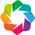

In [19]:
import datashader as ds
import holoviews as hv
from holoviews.operation.datashader import datashade, shade, dynspread, rasterize
from holoviews.operation import decimate
hv.extension("bokeh")

In [20]:
data = hv.Points(pandas_dataframe, ["intercept", "gradient"])
plot = datashade(data)

# Holoviews

In [30]:
# Tools to select data
opts.defaults(opts.Points(tools=['box_select', 'lasso_select']))

# Random points to plot
crossplot = 0#hv.Points(dask_dataframe, ["intercept", "gradient"])

# Holoviews
#selection = streams.Selection1D(source = crossplot)

# Selected points by Holoviews selection stream
selected_box = hv.DynamicMap(lambda index: crossplot.iloc[index],
                             kdims=[], streams = [selection])

# Final Overlay
Overlay = 0 #(crossplot * selected_box).opts(padding = 0.01)
Overlay

0

In [114]:
#x = selection
x = [700, 1000]

## Do something with the index in selection1D variable

In [115]:
def gas_dataframe(avo_dataframe, selected_points):

    for trace_index in selected_points:
        t_number = avo_dataframe["trace_number"].iloc[trace_index]
        if trace_index == x[0]:
            trace_with_hc = avo_dataframe[avo_dataframe["trace_number"] == t_number]
            hc = avo_dataframe.iloc[trace_index]
        else:
            trace_with_hc = pd.concat([trace_with_hc, avo_dataframe[avo_dataframe["trace_number"] == t_number]], axis = 0)
            hc = pd.concat([hc, avo_dataframe.iloc[trace_index]],
                                       ignore_index = False, axis="columns")

    return [hc.transpose(), trace_with_hc]

In [116]:
hc_dataframe, trace_with_hc= gas_dataframe(pandas_dataframe, x)
hc_dataframe

,trace_number,utmx,utmy,time_slice,gradient,intercept,rvalue,pvalue,sdeviation
700,12.0,3994377.0,84666698.0,2780.0,-9.433977,-4.868809,-0.294170,0.809914,15.818667
1000,16.0,3993994.0,84667020.0,2972.0,-5.641462,1.668105,0.109829,0.929940,15.096356


In [156]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm

fig = plt.figure(figsize=(15, 15))
ax = fig.add_subplot(111, projection='3d')

xs = trace_with_hc["utmx"].values
ys = trace_with_hc["utmy"].values
zs = trace_with_hc["time_slice"].values

plot = ax.scatter(xs, ys, zs, zdir ='z', s =1, c = "black", depthshade = False, marker = ".", label = "samples")

xhc = hc_dataframe["utmx"].values
yhc = hc_dataframe["utmy"].values
zhc = hc_dataframe["time_slice"].values

plot = ax.scatter(xhc, yhc, zhc, zdir = 'z', s = 100, c = "red", depthshade = False, marker = "o", label = "Selected Points")
plot = ax.plot(xhc, yhc, zhc, c = "red", linewidth = 1, linestyle = "--")
ax.set_xlabel('Utmx [m]')
ax.set_ylabel('Utmy [m]')
ax.set_zlabel('Time slice [ms]')
ax.invert_zaxis()
ax.legend()



fig.savefig('test.png', dpi = 160, format = "png", bbox_inches = 'tight')
plt.close(fig)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
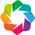

:RGB   [x,y]   (R,G,B,A)

In [161]:
hv.extension("bokeh")
hv.RGB.load_image('test.png').opts(width = 800, height = 400, xaxis=None, yaxis=None)

# Datashader

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
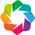

In [19]:
import datashader as ds
import holoviews as hv
from holoviews import opts
from holoviews import streams
from holoviews.operation.datashader import datashade, shade, dynspread, rasterize
from holoviews.operation import decimate
hv.extension("bokeh")
import time

In [22]:
%%time
points = hv.Points(dask_dataframe, ["intercept","gradient", ])

CPU times: user 4.09 ms, sys: 14 µs, total: 4.1 ms
Wall time: 4.03 ms


In [23]:
%%time
#points

CPU times: user 6 µs, sys: 1 µs, total: 7 µs
Wall time: 13.4 µs


In [24]:
dat_options = dict(width = 500, height = 500, bgcolor = "white", tools=['box_select', 'lasso_select'])
#points_datashader = datashade(points, cmap = "black", normalization = "log").opts(plot = dat_options)
#selection = streams.Selection1D(source=points_datashader)

dmap = hv.DynamicMap(points).opts(show_frame = True, show_grid = True, padding = 0.1)
dmap

:DynamicMap   []
   :Points   [intercept,gradient]   (trace_number,utmx,utmy)

In [37]:
# Declare points as source of selection stream
selection = streams.Selection1D(source=points)

# Write function that uses the selection indices to slice points and compute stats
def selected_info(index):
    selected = points.iloc[index]
    if index:
        label = 'Mean x, y: %.3f, %.3f' % tuple(selected.array().mean(axis=0))
    else:
        label = 'No selection'
    return selected.relabel(label).opts(color='red')

# Combine points and DynamicMap
points + hv.DynamicMap(selected_info, streams=[selection])

Scatter

Online example: http://holoviews.org/reference/elements/bokeh/Scatter.html

-------------
Style Options
-------------

	alpha, angle, cmap, color, fill_alpha, fill_color, hover_alpha, hover_color, hover_fill_alpha, hover_fill_color, hover_line_alpha, hover_line_color, line_alpha, line_cap, line_color, line_dash, line_join, line_width, marker, muted_alpha, muted_color, muted_fill_alpha, muted_fill_color, muted_line_alpha, muted_line_color, nonselection_alpha, nonselection_color, nonselection_fill_alpha, nonselection_fill_color, nonselection_line_alpha, nonselection_line_color, palette, selection_alpha, selection_color, selection_fill_alpha, selection_fill_color, selection_line_alpha, selection_line_color, size

(Consult bokeh's documentation for more information.)

------------
Plot Options
------------

The plot options are the parameters of the plotting class:

Parameters of 'PointPlot'

Parameters changed from their default values are marked in red.
Soft bound values are mar

In [34]:
points_datashader = datashade(dmap, cmap = "black", normalization = "log").opts(plot = dat_options)
points_datashader

:DynamicMap   []
   :RGB   [intercept,gradient]   (R,G,B,A)

# Dask delay
could i use this to make the arrays and then store them??? YES
input files according to the speaker
one thing to all o f them
combine them
then show them?


In [69]:
def inc(x):
    return x+1

def add(x, y):
    return x*y

In [79]:
%%time
q = inc(np.arange(10000))
w = inc(np.arange(10000, 20000))
e = add(q,w) 

CPU times: user 445 µs, sys: 203 µs, total: 648 µs
Wall time: 517 µs


In [76]:
from dask import delayed

In [83]:
%%time
xxx = delayed(inc)(np.arange(10000))
yyy = delayed(inc)(np.arange(10000, 20000))
zzz = delayed(add)(xxx,yyy)

CPU times: user 1.19 ms, sys: 539 µs, total: 1.73 ms
Wall time: 1.19 ms


In [84]:
# run the thing before
zzz.compute()

array([    10001,     20004,     30009,     40016,     50025,     60036,
           70049,     80064,     90081,    100100,    110121,    120144,
          130169,    140196,    150225,    160256,    170289,    180324,
          190361,    200400,    210441,    220484,    230529,    240576,
          250625,    260676,    270729,    280784,    290841,    300900,
          310961,    321024,    331089,    341156,    351225,    361296,
          371369,    381444,    391521,    401600,    411681,    421764,
          431849,    441936,    452025,    462116,    472209,    482304,
          492401,    502500,    512601,    522704,    532809,    542916,
          553025,    563136,    573249,    583364,    593481,    603600,
          613721,    623844,    633969,    644096,    654225,    664356,
          674489,    684624,    694761,    704900,    715041,    725184,
          735329,    745476,    755625,    765776,    775929,    786084,
          796241,    806400,    816561,    826724, 

# Dask Arrays
we can process an array in chunks and see the hole thing as a single array""!!!! 
Traces arrays fit into memory. What does not fit is the dataframe

In [85]:
array = dask.from_array(data, chunks = (10000, ))

NameError: name 'dask' is not defined

In [ ]:
dask.stack concatenates the arrays. 1:03:02

# Dask DataFrames
dask dataframes are sort by blocks, where these are pandas dataframes     
no work with datashader, we need a DASK DATAFRAME:     
Simultaniously, maka a dataframe then store it in a dask    
In my case: functions should extract the trace info then concatenates with the dataframe.... Dask dataframe should get a chunk per trace = 1501

In [112]:
y = np.full((1501, ), 69)

In [104]:
x.fill(5)

In [111]:
print(y)

None


In [83]:
hv.extension("matplotlib")

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

In [81]:
y,x = np.arange(0,100), np.arange(100,200)
heights = np.sin(x**2+y**2)

In [85]:
hv.Scatter3D([x, y, heights])

ValueError: operands could not be broadcast together with remapped shapes [original->remapped]: (0,4) and requested shape (3,4)

:Scatter3D   [x,y,z]